## 1. 사용 library import

In [1]:
import os
from time import sleep, time
from collections import deque
from itertools import combinations
from pprint import pprint
import math

import numpy as np
import pandas as pd

from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from umap import UMAP

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
import squarify

from pandas_profiling import ProfileReport

plt.style.use('seaborn-whitegrid')
matplotlib.rcParams['font.family']='Malgun Gothic'
matplotlib.rcParams['axes.unicode_minus'] = False

import warnings
warnings.filterwarnings('ignore')

## 2. 생성된 Data Frame 불러오기

In [2]:
df = pd.read_csv('./data/2020_torunaments.csv')
df.head()

,dbnos,assists,boosts,damage_dealt,death_type,headshot_kills,heals,kill_place,kill_streaks,kills,...,walk_distance,weapons_acquired,win_place,match_mapName,match_duration,match_createdAt,roster_rank,roster_won,tournament_id,tournament_createdAt
0,1,0,2,178.78679,byplayer,0,7,20,1,1,...,706.84840,7,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
1,0,0,1,0.00000,byplayer,0,1,33,0,0,...,630.31635,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
2,1,0,1,100.00000,byplayer,0,3,34,0,0,...,1328.34330,3,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
3,1,0,0,207.98430,byplayer,0,1,21,1,1,...,1109.39770,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
4,1,0,3,189.19508,byplayer,1,6,25,1,1,...,1024.16360,3,8,Miramar,1742,2020-12-19T07:39:25Z,8,False,as-pwi20,2020-12-19T07:04:54Z


## 3. DataFrame 전처리

In [3]:
def preprocess(df):
    ### 1. 이름 전처리
    
    # 1-1. 이름 소문자로 변경
    df['name'] = df.name.str.lower()
    
    # 1-2. 팀명 컬럼 생성
    tmp =  df['name'].str.split('_', expand=True) # 분할 dataframe
    df['team_name'] = tmp[0]
    
    # 1-3. 선수 name 컬럼 변경
    tmp.fillna('', inplace=True)
    df['name'] = tmp.iloc[:, 1:].sum(axis=1)
    
    # 1-4. '_'가 아닌 '-'로 구분한 아이디 처리
    tmp = df.loc[df['name']=='', 'team_name'].str.split('-',  expand=True)
    tmp.fillna('', inplace=True)
    df.loc[df['name']=='', 'team_name'] =  tmp[0]
    df.loc[df['name']=='', 'name'] = tmp.iloc[:, 1:].sum(axis=1)
    
    # 1-5. 'name'이 없다면 삭제
    df = df.query("name!=''")
    
    ### 2. 날짜 데이터 타입 변경
    for col in set(df.columns) - set(['match_mapName','match_createdAt', 'death_type', 'name', 'team_name', 'player_id', 'roster_won', 'tournament_id', 'tournament_createdAt']):
        df[col] = df[col].astype(np.float32)
        df['match_createdAt'] = pd.to_datetime(df['match_createdAt'])
        df['tournament_createdAt'] = pd.to_datetime(df['tournament_createdAt'])
    
    ### 3. logout 데이터 삭제
    df = df.query("death_type!='logout'")
    
    #### 4. relative_time_survived 컬럼 생성
    df['relative_time_survived'] = df.time_survived / df.match_duration
    df.loc[df['relative_time_survived']>1, 'relative_time_survived'] = 1
    df.loc[df['relative_time_survived'] == np.inf, 'relative_time_survived'] = 0
    
    #### 5. total_distance 생성
    df['total_distance'] = df[['ride_distance', 'swim_distance', 'walk_distance']].sum(axis=1)
    
    #### 6. match 별 참가팀 10개 이하 삭제
    gp_by_match = df.groupby(['match_createdAt'])
    for date, tmp in gp_by_match:
        if len(tmp['roster_rank'].unique()) <= 10:
            df.drop(index = tmp.index.values, inplace=True)    
    
    #### 7. 토너먼트에서 참가한 경기수가 5개 미만 or 팀원의 수가 3명 미만 삭제
    gp_by_tour_team = df.groupby(['tournament_id', 'team_name', 'name'])[['match_createdAt']].count()
    tour_ids = df['tournament_id'].unique()
    tour_dict = {tour_id:set()  for tour_id in tour_ids}
    for a,b ,c in gp_by_tour_team.index:
        tour_dict[a].add(b)
    for tour_id in tour_ids:
        for team_name in tour_dict[tour_id]:
            if gp_by_tour_team.loc[(tour_id, team_name), :].max()[0] <5 or gp_by_tour_team.loc[(tour_id, team_name), :].shape[0]<=3:
                cond = (df.tournament_id==tour_id) & (df.team_name==team_name)
                df = df.loc[~cond]
        
    #### 8. win_place 컬럼 삭제
    df.drop(columns=['win_place'], inplace=True)
    
    #### 9. relative_rank 컬럼 생성
#     gp_by_match = df.groupby(['match_createdAt'])
#     df['relative_rank'] = np.nan
#     for date, tmp in gp_by_match:
#         l = len(tmp['roster_rank'].unique())
#         df.loc[tmp.index.values,'relative_rank'] = df.loc[tmp.index.values,'roster_rank'] / l
    
    ### 10. relative_damage_dealt
    df['relative_damage_dealt'] = df.damage_dealt / df.time_survived

    ### 11. relative_kills
    df['relative_kills'] = df.damage_dealt / df.time_survived
    
    ### 12. tournament_id = eu-testq 제거  
    df = df.query('tournament_id!="eu-testq"')
    return df
df = preprocess(df)

##  4. 참여 컬럼(numeric columns)

In [4]:
df_dtypes_except_d = df.dtypes[(df.dtypes!='datetime64[ns, UTC]')==True]
df_columns_except_d = df.columns[(df.dtypes!='datetime64[ns, UTC]')==True]

In [5]:
num_columns = [c for c, d in zip(df_columns_except_d, df_dtypes_except_d)  if d!='O' and d!='bool']
num_columns.extend(['name', 'match_mapName'])
df_num = df[num_columns]
df_num

,dbnos,assists,boosts,damage_dealt,headshot_kills,heals,kill_place,kill_streaks,kills,longest_kill,...,walk_distance,weapons_acquired,match_duration,roster_rank,relative_time_survived,total_distance,relative_damage_dealt,relative_kills,name,match_mapName
0,1.0,0.0,2.0,178.786789,0.0,7.0,20.0,1.0,1.0,4.594472,...,706.848389,7.0,1742.0,4.0,0.960845,10779.292969,0.106815,0.106815,ssees,Miramar
1,0.0,0.0,1.0,0.000000,0.0,1.0,33.0,0.0,0.0,0.000000,...,630.316345,4.0,1742.0,4.0,0.632143,10652.504883,0.000000,0.000000,melofo,Miramar
2,1.0,0.0,1.0,100.000000,0.0,3.0,34.0,0.0,0.0,0.000000,...,1328.343262,3.0,1742.0,4.0,0.625406,10892.470703,0.091789,0.091789,machao,Miramar
3,1.0,0.0,0.0,207.984299,0.0,1.0,21.0,1.0,1.0,104.266151,...,1109.397705,4.0,1742.0,4.0,0.634925,10456.398438,0.188044,0.188044,gokuri,Miramar
4,1.0,0.0,3.0,189.195084,1.0,6.0,25.0,1.0,1.0,227.473068,...,1024.163574,3.0,1742.0,8.0,0.834440,11342.478516,0.130157,0.130157,eguto,Miramar
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135155,0.0,0.0,3.0,18.449999,0.0,1.0,44.0,0.0,0.0,0.000000,...,1137.948242,5.0,1818.0,7.0,0.843335,13754.791992,0.012034,0.012034,resunzmall,Miramar
135156,0.0,1.0,4.0,27.376270,0.0,0.0,56.0,0.0,0.0,0.000000,...,2369.788574,7.0,1818.0,13.0,0.712781,4756.468262,0.021126,0.021126,psychopathy-,Miramar
135157,0.0,0.0,2.0,0.000000,0.0,0.0,57.0,0.0,0.0,0.000000,...,1164.915039,6.0,1818.0,13.0,0.616426,3874.777588,0.000000,0.000000,helloweend,Miramar
135158,1.0,0.0,8.0,78.000000,0.0,1.0,30.0,1.0,1.0,23.056494,...,1480.251465,5.0,1818.0,13.0,0.692196,3855.413330,0.061983,0.061983,kimhayur,Miramar


In [6]:
df_num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 132020 entries, 0 to 135159
Data columns (total 27 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   dbnos                   132020 non-null  float32
 1   assists                 132020 non-null  float32
 2   boosts                  132020 non-null  float32
 3   damage_dealt            132020 non-null  float32
 4   headshot_kills          132020 non-null  float32
 5   heals                   132020 non-null  float32
 6   kill_place              132020 non-null  float32
 7   kill_streaks            132020 non-null  float32
 8   kills                   132020 non-null  float32
 9   longest_kill            132020 non-null  float32
 10  revives                 132020 non-null  float32
 11  ride_distance           132020 non-null  float32
 12  road_kills              132020 non-null  float32
 13  swim_distance           132020 non-null  float32
 14  team_kills          

## 5. 맵별 grouping

In [8]:
df.groupby('match_mapName')['name'].count()

match_mapName
Erangel                  1526
Erangel (Remastered)    64955
Miramar                 61293
Sanhok                   4246
Name: name, dtype: int64

In [10]:
df_Miramar = df_num.query('match_mapName=="Miramar"')
df_Erangel = df_num.query('match_mapName=="Erangel (Remastered)"')

## 6. 선수별 grouping (mean 기준)

In [11]:
df_Miramar_train = df_Miramar.groupby('name').mean()
df_Erangel_train = df_Erangel.groupby('name').mean()

## 7. clustering

### 7.1. Miramar(모든 컬럼)

#### - scaling

In [12]:
scaler_Miramar = StandardScaler()
df_Miramar_train_scaled = scaler_Miramar.fit_transform(df_Miramar_train)

#### - elbow 기법

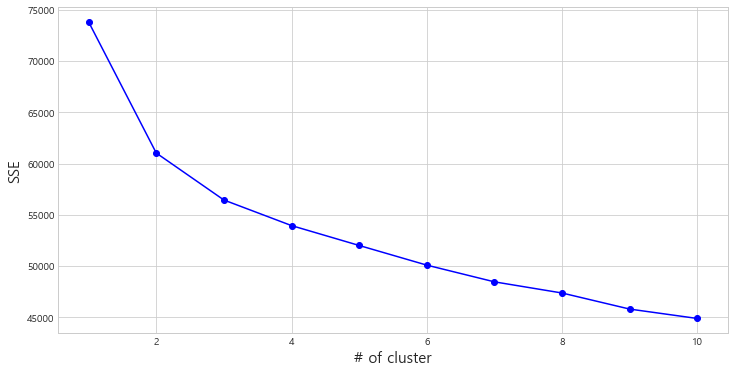

In [13]:
sse = []
for n in range(1,11):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_Miramar_train_scaled)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 11), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

#### - 실루엣 계수

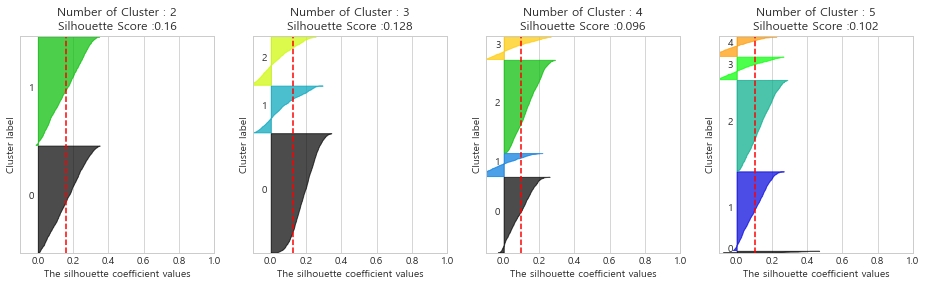

In [14]:
### 여러개의 클러스터링 갯수를 List로 입력 받아 각각의 실루엣 계수를 면적으로 시각화한 함수 작성
def visualize_silhouette(clustering, X_features, cluster_lists): 
    
    # 입력값으로 클러스터링 갯수들을 리스트로 받아서, 각 갯수별로 클러스터링을 적용하고 실루엣 개수를 구함
    n_cols = len(cluster_lists)
    
    # plt.subplots()으로 리스트에 기재된 클러스터링 수만큼의 sub figures를 가지는 axs 생성 
    fig, axs = plt.subplots(figsize=(4*n_cols, 4), nrows=1, ncols=n_cols)
    
    # 리스트에 기재된 클러스터링 갯수들을 차례로 iteration 수행하면서 실루엣 개수 시각화
    for ind, n_cluster in enumerate(cluster_lists):
        
        if clustering[0] == 'hierarchical':
            model = AgglomerativeClustering(n_clusters=n_cluster, linkage=clustering[1])
        elif clustering[0] == 'kmeans':
            model = KMeans(n_clusters=n_cluster)
        # KMeans 클러스터링 수행하고, 실루엣 스코어와 개별 데이터의 실루엣 값 계산. 
        cluster_labels = model.fit_predict(X_features)
        
        #if clustering[0] == 'dbscan':
        #    n_cluster = len(set(cluster_labels))-1
        
        sil_avg = silhouette_score(X_features, cluster_labels)
        sil_values = silhouette_samples(X_features, cluster_labels)
        
        y_lower = 10
        axs[ind].set_title('Number of Cluster : '+ str(n_cluster)+'\n' \
                          'Silhouette Score :' + str(round(sil_avg,3)) )
        axs[ind].set_xlabel("The silhouette coefficient values")
        axs[ind].set_ylabel("Cluster label")
        axs[ind].set_xlim([-0.1, 1])
        axs[ind].set_ylim([-1, len(X_features) + (n_cluster + 1) * 10])
        axs[ind].set_yticks([])  # Clear the yaxis labels / ticks
        axs[ind].set_xticks([0, 0.2, 0.4, 0.6, 0.8, 1])
        
        # 클러스터링 갯수별로 fill_betweenx( )형태의 막대 그래프 표현. 
        for i in range(n_cluster):
            ith_cluster_sil_values = sil_values[cluster_labels==i]
            ith_cluster_sil_values.sort()
            
            size_cluster_i = ith_cluster_sil_values.shape[0]
            y_upper = y_lower + size_cluster_i
            
            color = cm.nipy_spectral(float(i) / n_cluster)
            axs[ind].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_sil_values, \
                                facecolor=color, edgecolor=color, alpha=0.7)
            axs[ind].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10
            
        axs[ind].axvline(x=sil_avg, color="red", linestyle="--")
visualize_silhouette(['kmeans'], df_Miramar_train_scaled, [2, 3, 4, 5])

#### - k-means clustering(5개)

In [15]:
kmeans = KMeans(n_clusters=5, random_state=101)
kmeans.fit(df_Miramar_train_scaled)
res = kmeans.predict(df_Miramar_train_scaled)

df_res_Miramar = pd.DataFrame(df_Miramar_train_scaled, columns=df_Miramar_train.columns)
df_res_Miramar['label'] = res

#### - 2차원 시각화

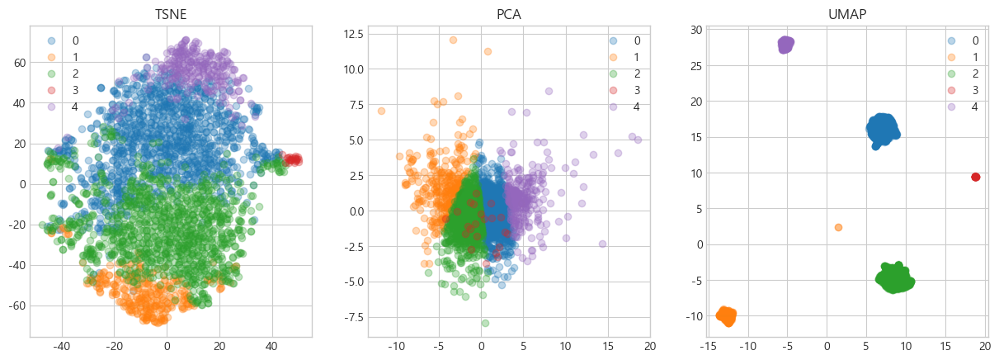

In [16]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_Miramar_train_scaled, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(5):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Miramar_train_scaled, res)
for i in range(5):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_Miramar_train_scaled, res)

for i in range(5):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

##### pca 설명력

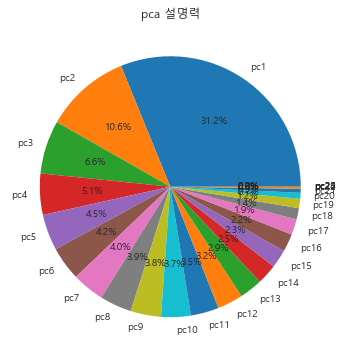

In [17]:
pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Miramar_train_scaled, res)

explained_variance_ratio = pd.Series(pca.explained_variance_ratio_, index=[f'pc{i}' for i in range(1, df_Miramar_train_scaled.shape[1]+1)])

fig, ax = plt.subplots(1, 1, figsize=(15, 6))
explained_variance_ratio.plot.pie(autopct='%1.1f%%', ax= ax)
ax.set_ylabel('')
ax.set_title('pca 설명력')
plt.show()

#### - clustering label 불포

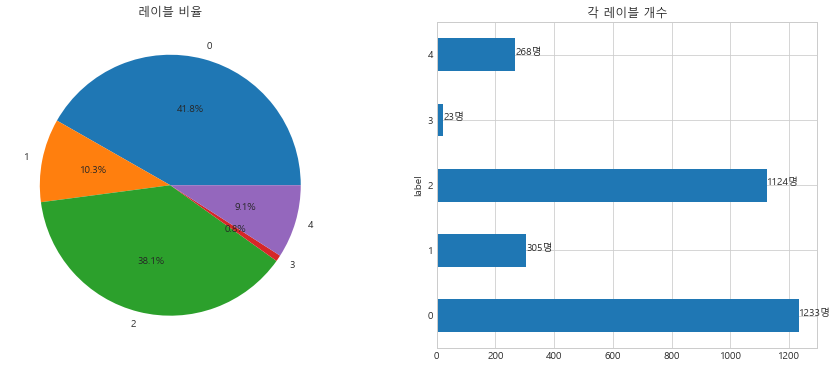

In [18]:
count_label = df_res_Miramar.groupby('label')['headshot_kills'].count()

fig, ax = plt.subplots(1, 2, figsize=(15, 6))
count_label.plot.pie(autopct='%1.1f%%', ax= ax[0])
ax[0].set_ylabel('')
ax[0].set_title('레이블 비율')

df_res_Miramar.groupby('label')['headshot_kills'].count().plot.barh(ax=ax[1])
ax[1].text(count_label[0], 0, f'{count_label[0]}명')
ax[1].text(count_label[1], 1, f'{count_label[1]}명')
ax[1].text(count_label[2], 2, f'{count_label[2]}명')
ax[1].text(count_label[3], 3, f'{count_label[3]}명')
ax[1].text(count_label[4], 4, f'{count_label[4]}명')
ax[1].set_title('각 레이블 개수')

plt.show()

#### - 컬럼별 분포

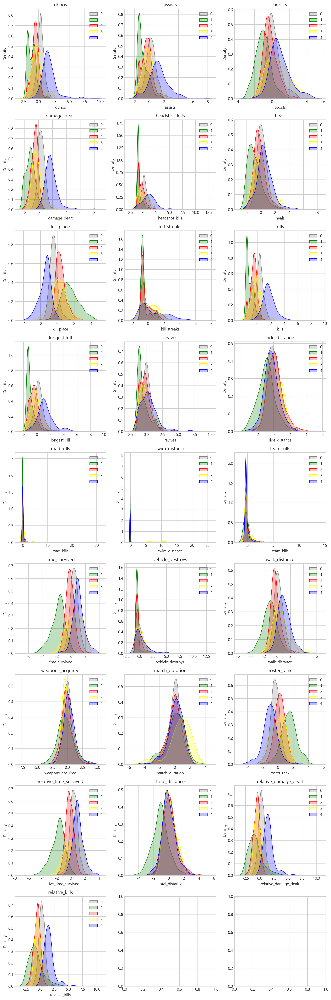

In [19]:
fig, ax = plt.subplots(9, 3, figsize=(12, 36), dpi=200)
for axis, col in zip(ax.flatten(), df_res_Miramar.columns[:-1]):
    sns.kdeplot(data=df_res_Miramar.query('label==0')[col], color='gray', shade=True, label='0', ax=axis)
    sns.kdeplot(data=df_res_Miramar.query('label==1')[col], color='green', shade=True, label='1', ax=axis)
    sns.kdeplot(data=df_res_Miramar.query('label==2')[col], color='red', shade=True, label='2', ax=axis)  
    sns.kdeplot(data=df_res_Miramar.query('label==3')[col], color='yellow', shade=True, label='3', ax=axis)
    sns.kdeplot(data=df_res_Miramar.query('label==4')[col], color='blue', shade=True, label='4', ax=axis)  
    axis.set_title(col)
    axis.legend()
fig.tight_layout()
fig.show()

* 제거할 컬럼
    * weapons_acquired
    * road_kills
    * swim_distance
    * team_kills
    * revives
    * vehicle_destroys
    * match_duration
    * kill_streaks
    * headshot_kills
    * ride_distance

### 7.2. Miramar (저해 컬럼 제거)

#### - 컬럼 제거

In [20]:
df_Miramar_train1 = df_Miramar_train.drop(columns=['weapons_acquired', 'road_kills', 'swim_distance', 'team_kills', 'revives', 'vehicle_destroys', 'match_duration', 'kill_streaks', 'headshot_kills', 'ride_distance'])

#### - scaling

In [21]:
scaler_Miramar = StandardScaler()
df_Miramar_train_scaled1 = scaler_Miramar.fit_transform(df_Miramar_train1)

#### - elbow 기법

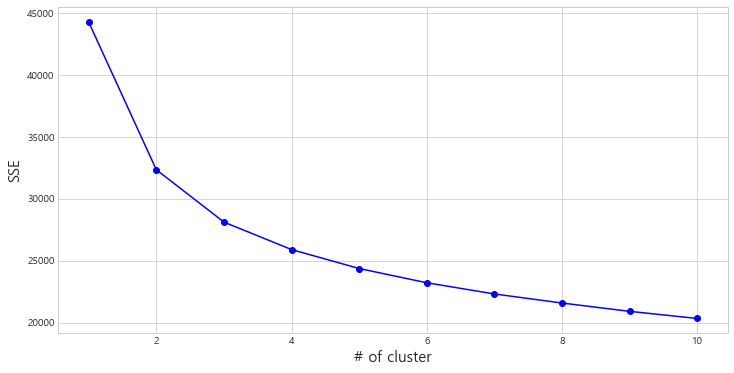

In [22]:
sse = []
for n in range(1,11):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_Miramar_train_scaled1)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 11), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

#### - k-means clustering(5개)

In [52]:
kmeans_Miramar = KMeans(n_clusters=5, random_state=101)
kmeans_Miramar.fit(df_Miramar_train_scaled1)
res = kmeans_Miramar.predict(df_Miramar_train_scaled1)

df_res_Miramar1 = pd.DataFrame(df_Miramar_train_scaled1, columns=df_Miramar_train1.columns)
df_res_Miramar1['label'] = res

#### - 2차원 시각화

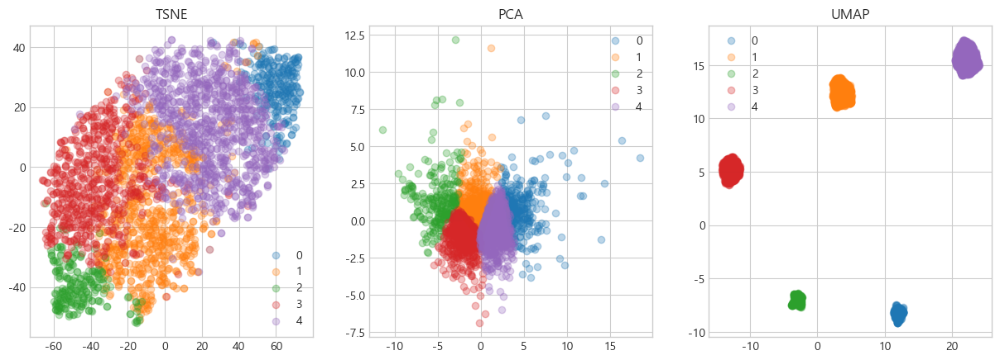

In [24]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_Miramar_train_scaled1, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(5):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Miramar_train_scaled1, res)
for i in range(5):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_Miramar_train_scaled1, res)

for i in range(5):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

##### pca 설명력

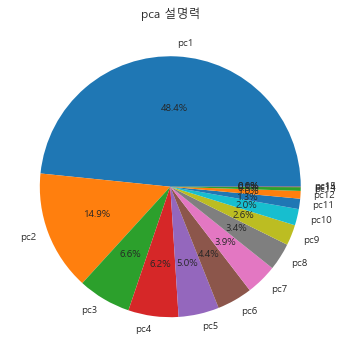

In [25]:
pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Miramar_train_scaled1, res)

explained_variance_ratio = pd.Series(pca.explained_variance_ratio_, index=[f'pc{i}' for i in range(1, df_Miramar_train_scaled1.shape[1]+1)])

fig, ax = plt.subplots(1, 1, figsize=(15, 6))
explained_variance_ratio.plot.pie(autopct='%1.1f%%', ax= ax)
ax.set_ylabel('')
ax.set_title('pca 설명력')
plt.show()

#### - clustering label 분포

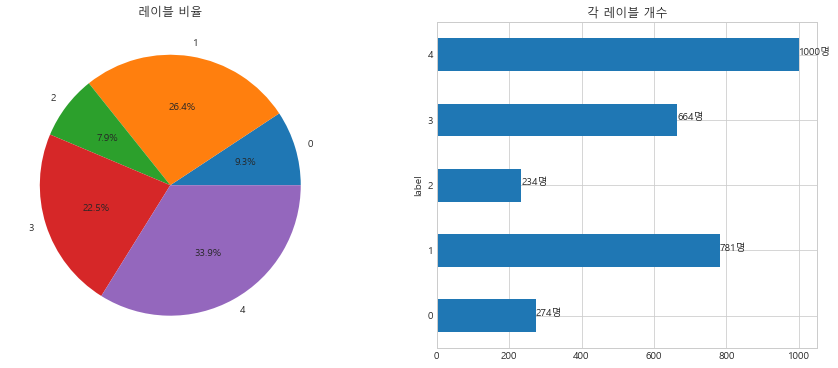

In [80]:
count_label = df_res_Miramar1.groupby('label')['kills'].count()

fig, ax = plt.subplots(1, 2, figsize=(15, 6))
count_label.plot.pie(autopct='%1.1f%%', ax= ax[0])
ax[0].set_ylabel('')
ax[0].set_title('레이블 비율')

df_res_Miramar1.groupby('label')['kills'].count().plot.barh(ax=ax[1])
ax[1].text(count_label[0], 0, f'{count_label[0]}명')
ax[1].text(count_label[1], 1, f'{count_label[1]}명')
ax[1].text(count_label[2], 2, f'{count_label[2]}명')
ax[1].text(count_label[3], 3, f'{count_label[3]}명')
ax[1].text(count_label[4], 4, f'{count_label[4]}명')
ax[1].set_title('각 레이블 개수')

plt.show()

#### - 컬럼별 분포

##### kde 분포

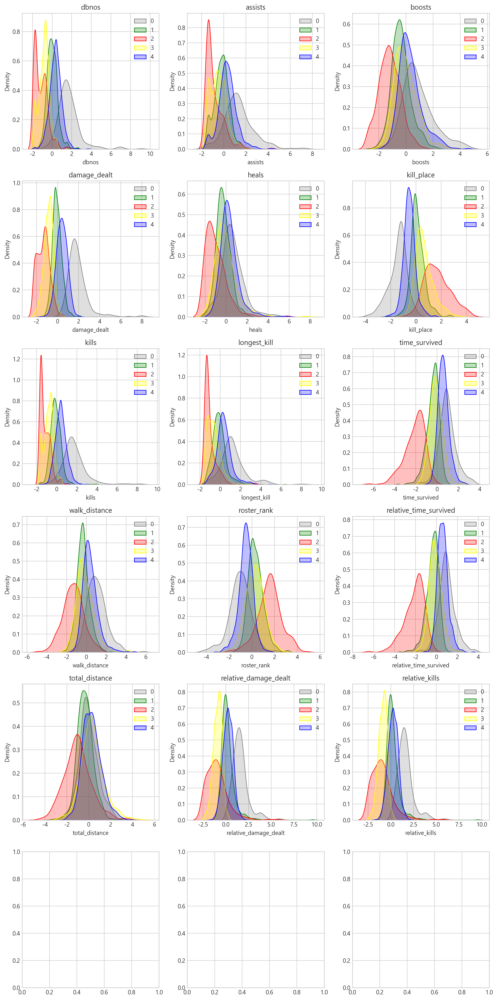

In [81]:
fig, ax = plt.subplots(6, 3, figsize=(12, 24), dpi=200)
for axis, col in zip(ax.flatten(), df_res_Miramar1.columns[:-1]):
    sns.kdeplot(data=df_res_Miramar1.query('label==0')[col], color='gray', shade=True, label='0', ax=axis)
    sns.kdeplot(data=df_res_Miramar1.query('label==1')[col], color='green', shade=True, label='1', ax=axis)
    sns.kdeplot(data=df_res_Miramar1.query('label==2')[col], color='red', shade=True, label='2', ax=axis)  
    sns.kdeplot(data=df_res_Miramar1.query('label==3')[col], color='yellow', shade=True, label='3', ax=axis)
    sns.kdeplot(data=df_res_Miramar1.query('label==4')[col], color='blue', shade=True, label='4', ax=axis)  
    axis.set_title(col)
    axis.legend()
fig.tight_layout()
fig.show()

##### boxplot

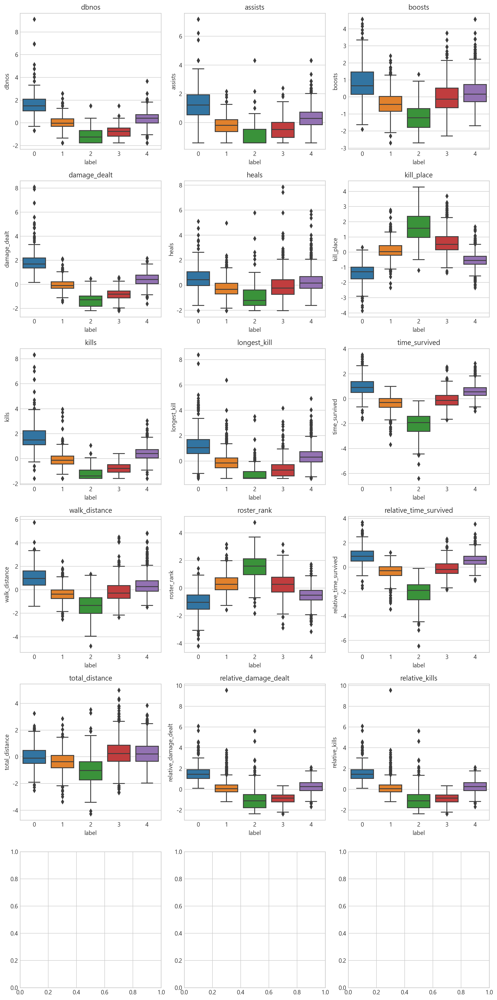

In [29]:
fig, ax = plt.subplots(6, 3, figsize=(12, 24), dpi=200)
for axis, col in zip(ax.flatten(), df_res_Miramar1.columns[:-1]):
    sns.boxplot(data=df_res_Miramar1, x='label', y=col, ax=axis)    
    axis.set_title(col)

fig.tight_layout()
fig.show()

#### - 2차원 분포

##### scatterplot

<Figure size 1296x1296 with 0 Axes>

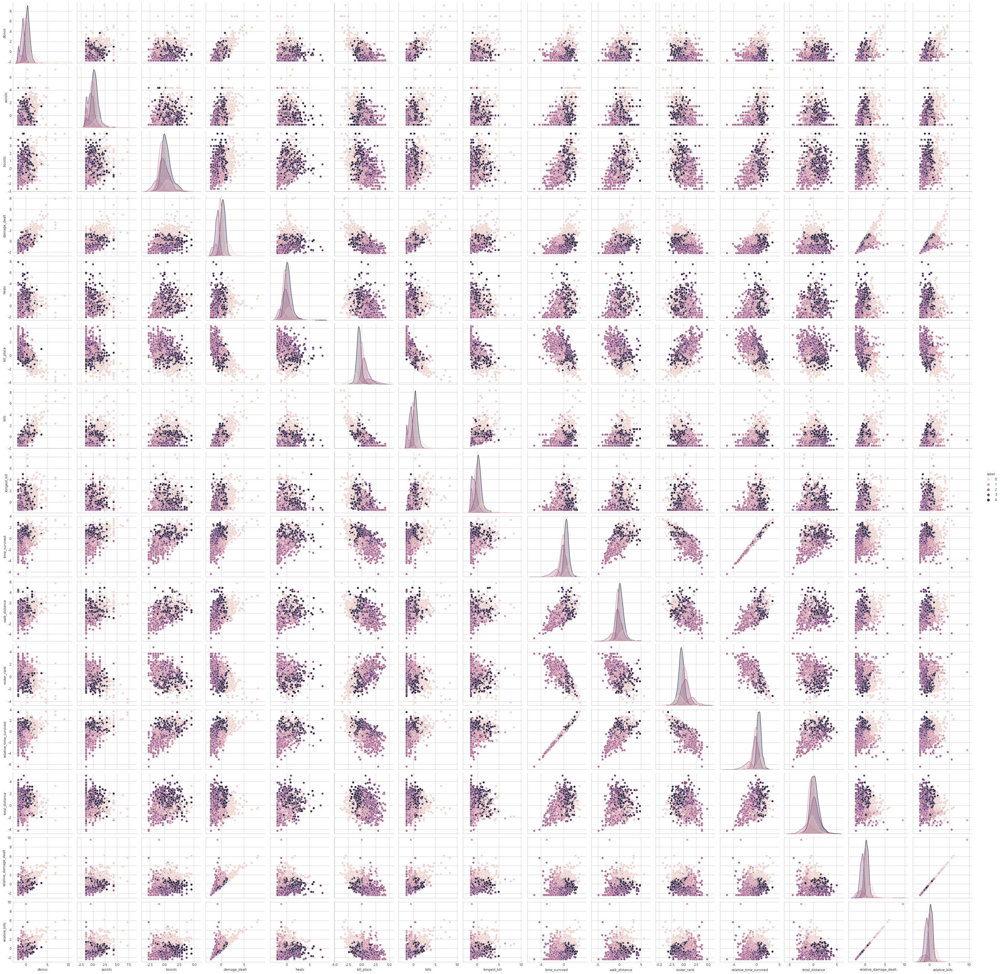

In [30]:
plt.figure(figsize=(18, 18))
sns.pairplot(df_res_Miramar1, hue='label')
plt.show()

-------------------------------------------

### 7.3. Erangel

#### -scaling

In [31]:
scaler_Erangel = StandardScaler()
df_Erangel_train_scaled = scaler_Miramar.fit_transform(df_Erangel_train)

#### - elbow 기법

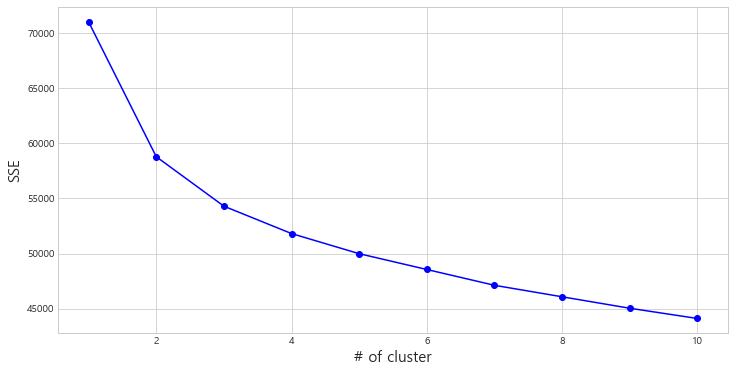

In [32]:
sse = []
for n in range(1,11):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_Erangel_train_scaled)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 11), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

#### - 실루엣 계수

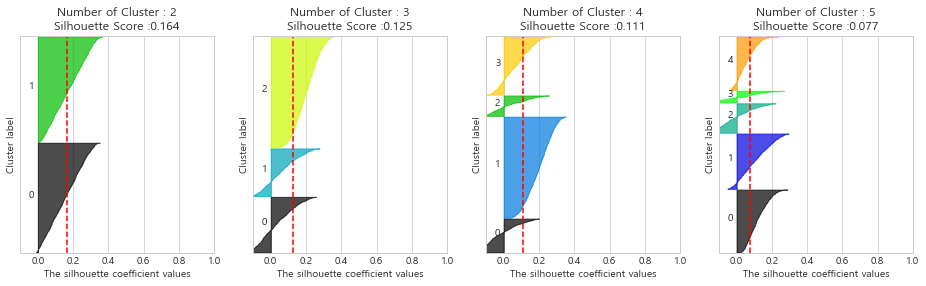

In [33]:
### 여러개의 클러스터링 갯수를 List로 입력 받아 각각의 실루엣 계수를 면적으로 시각화한 함수 작성
def visualize_silhouette(clustering, X_features, cluster_lists): 
    
    # 입력값으로 클러스터링 갯수들을 리스트로 받아서, 각 갯수별로 클러스터링을 적용하고 실루엣 개수를 구함
    n_cols = len(cluster_lists)
    
    # plt.subplots()으로 리스트에 기재된 클러스터링 수만큼의 sub figures를 가지는 axs 생성 
    fig, axs = plt.subplots(figsize=(4*n_cols, 4), nrows=1, ncols=n_cols)
    
    # 리스트에 기재된 클러스터링 갯수들을 차례로 iteration 수행하면서 실루엣 개수 시각화
    for ind, n_cluster in enumerate(cluster_lists):
        
        if clustering[0] == 'hierarchical':
            model = AgglomerativeClustering(n_clusters=n_cluster, linkage=clustering[1])
        elif clustering[0] == 'kmeans':
            model = KMeans(n_clusters=n_cluster)
        # KMeans 클러스터링 수행하고, 실루엣 스코어와 개별 데이터의 실루엣 값 계산. 
        cluster_labels = model.fit_predict(X_features)
        
        #if clustering[0] == 'dbscan':
        #    n_cluster = len(set(cluster_labels))-1
        
        sil_avg = silhouette_score(X_features, cluster_labels)
        sil_values = silhouette_samples(X_features, cluster_labels)
        
        y_lower = 10
        axs[ind].set_title('Number of Cluster : '+ str(n_cluster)+'\n' \
                          'Silhouette Score :' + str(round(sil_avg,3)) )
        axs[ind].set_xlabel("The silhouette coefficient values")
        axs[ind].set_ylabel("Cluster label")
        axs[ind].set_xlim([-0.1, 1])
        axs[ind].set_ylim([-1, len(X_features) + (n_cluster + 1) * 10])
        axs[ind].set_yticks([])  # Clear the yaxis labels / ticks
        axs[ind].set_xticks([0, 0.2, 0.4, 0.6, 0.8, 1])
        
        # 클러스터링 갯수별로 fill_betweenx( )형태의 막대 그래프 표현. 
        for i in range(n_cluster):
            ith_cluster_sil_values = sil_values[cluster_labels==i]
            ith_cluster_sil_values.sort()
            
            size_cluster_i = ith_cluster_sil_values.shape[0]
            y_upper = y_lower + size_cluster_i
            
            color = cm.nipy_spectral(float(i) / n_cluster)
            axs[ind].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_sil_values, \
                                facecolor=color, edgecolor=color, alpha=0.7)
            axs[ind].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10
            
        axs[ind].axvline(x=sil_avg, color="red", linestyle="--")
visualize_silhouette(['kmeans'], df_Erangel_train_scaled, [2, 3, 4, 5])

#### - k-means clustering(5개)

In [34]:
kmeans = KMeans(n_clusters=5, random_state=101)
kmeans.fit(df_Erangel_train_scaled)
res = kmeans.predict(df_Erangel_train_scaled)

df_res_Erangel = pd.DataFrame(df_Erangel_train_scaled, columns=df_Erangel_train.columns)
df_res_Erangel['label'] = res

#### - 2차원 시각화

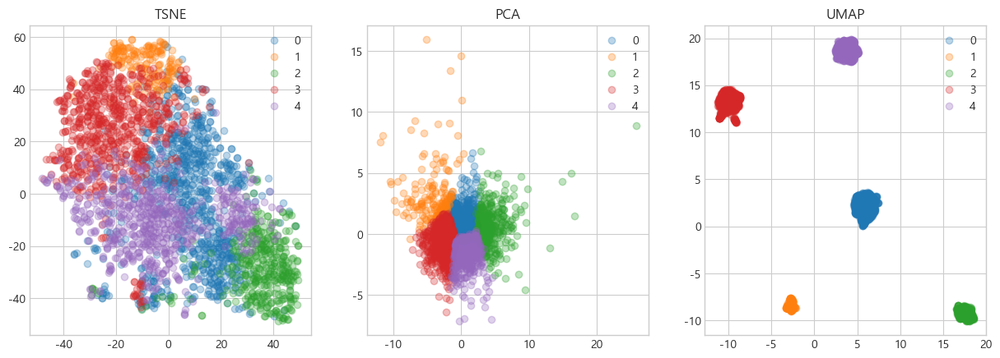

In [35]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_Erangel_train_scaled, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(5):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Erangel_train_scaled, res)
for i in range(5):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_Erangel_train_scaled, res)

for i in range(5):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

##### pca 설명력

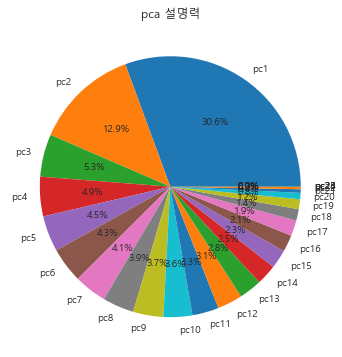

In [36]:
pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Erangel_train_scaled, res)

explained_variance_ratio = pd.Series(pca.explained_variance_ratio_, index=[f'pc{i}' for i in range(1, df_Erangel_train_scaled.shape[1]+1)])

fig, ax = plt.subplots(1, 1, figsize=(15, 6))
explained_variance_ratio.plot.pie(autopct='%1.1f%%', ax= ax)
ax.set_ylabel('')
ax.set_title('pca 설명력')
plt.show()

#### - clustering label 분포

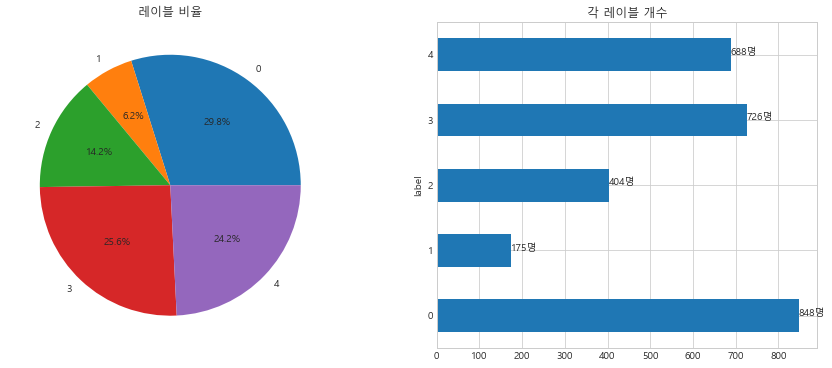

In [37]:
count_label = df_res_Erangel.groupby('label')['headshot_kills'].count()

fig, ax = plt.subplots(1, 2, figsize=(15, 6))
count_label.plot.pie(autopct='%1.1f%%', ax= ax[0])
ax[0].set_ylabel('')
ax[0].set_title('레이블 비율')

df_res_Erangel.groupby('label')['headshot_kills'].count().plot.barh(ax=ax[1])
ax[1].text(count_label[0], 0, f'{count_label[0]}명')
ax[1].text(count_label[1], 1, f'{count_label[1]}명')
ax[1].text(count_label[2], 2, f'{count_label[2]}명')
ax[1].text(count_label[3], 3, f'{count_label[3]}명')
ax[1].text(count_label[4], 4, f'{count_label[4]}명')
ax[1].set_title('각 레이블 개수')

plt.show()

#### - 컬럼별 분포

##### kde 분포

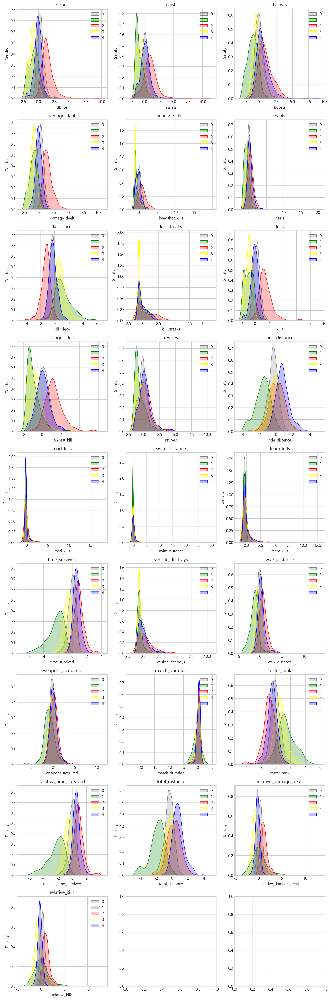

In [38]:
fig, ax = plt.subplots(9, 3, figsize=(12, 36), dpi=200)
for axis, col in zip(ax.flatten(), df_res_Miramar.columns[:-1]):
    sns.kdeplot(data=df_res_Erangel.query('label==0')[col], color='gray', shade=True, label='0', ax=axis)
    sns.kdeplot(data=df_res_Erangel.query('label==1')[col], color='green', shade=True, label='1', ax=axis)
    sns.kdeplot(data=df_res_Erangel.query('label==2')[col], color='red', shade=True, label='2', ax=axis)  
    sns.kdeplot(data=df_res_Erangel.query('label==3')[col], color='yellow', shade=True, label='3', ax=axis)
    sns.kdeplot(data=df_res_Erangel.query('label==4')[col], color='blue', shade=True, label='4', ax=axis)  
    axis.set_title(col)
    axis.legend()
fig.tight_layout()
fig.show()

* 제거할 컬럼
    * weapons_acquired
    * road_kills
    * swim_distance
    * team_kills
    * vehicle_destroys
    * match_duration
    * kill_streaks
    * headshot_kills
    * revives

### 7.3. Erangel(저해 컬럼 제거)

#### - 컬럼 제거

In [39]:
df_Erangel_train1 = df_Erangel_train.drop(columns=['weapons_acquired', 'road_kills', 'swim_distance', 'team_kills', 'vehicle_destroys', 'match_duration', 'kill_streaks', 'headshot_kills', 'revives'])

#### - scaling

In [40]:
scaler_Miramar = StandardScaler()
df_Erangel_train_scaled1 = scaler_Miramar.fit_transform(df_Erangel_train1)

#### - elbow 기법

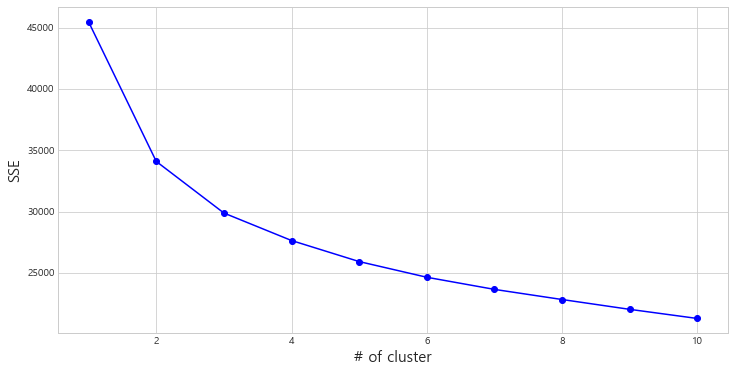

In [41]:
sse = []
for n in range(1,11):
    model = KMeans(n_clusters=n, random_state=101)
    km = model.fit(df_Erangel_train_scaled1)
    sse.append(km.inertia_)

plt.figure(figsize=(12, 6))
plt.plot(range(1, 11), sse, 'bo-')
plt.xlabel('# of cluster', fontsize=15)
plt.ylabel('SSE', fontsize=15)
plt.show()

#### - k-means clustering(5개)

In [49]:
kmeans_Erangel = KMeans(n_clusters=5, random_state=101)
kmeans_Erangel.fit(df_Erangel_train_scaled1)
res = kmeans_Erangel.predict(df_Erangel_train_scaled1)

df_res_Erangel1 = pd.DataFrame(df_Erangel_train_scaled1, columns=df_Erangel_train1.columns)
df_res_Erangel1['label'] = res

#### - 2차원으로 시각화

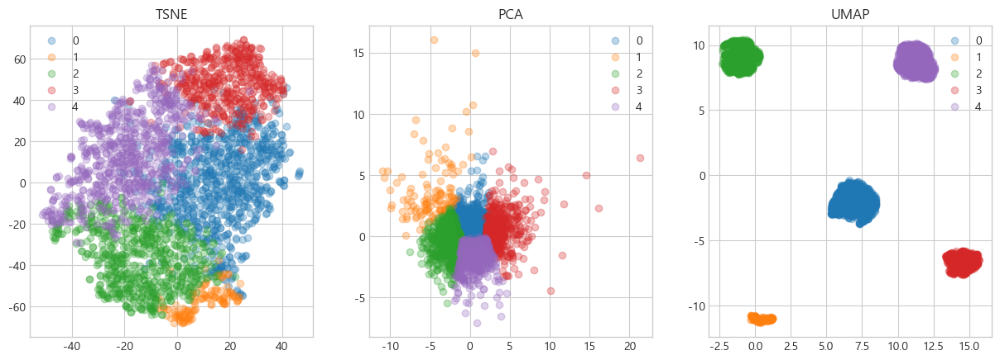

In [43]:
tsne = TSNE(random_state=0)
data_sample_dr = tsne.fit_transform(df_Erangel_train_scaled1, res)

fig, ax = plt.subplots(1, 3, figsize=(15, 5), dpi=100)

for i in range(5):
    ax[0].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[0].legend()
ax[0].set_title('TSNE')

pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Erangel_train_scaled1, res)
for i in range(5):
    ax[1].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[1].legend()
ax[1].set_title('PCA')

umap = UMAP(random_state=0)
data_sample_dr = umap.fit_transform(df_Erangel_train_scaled1, res)

for i in range(5):
    ax[2].scatter(data_sample_dr[:,0][res==i], data_sample_dr[:,1][res==i], 
               alpha=0.3, label=i)
ax[2].legend()
ax[2].set_title('UMAP')

plt.show()

#### - pca 설명력

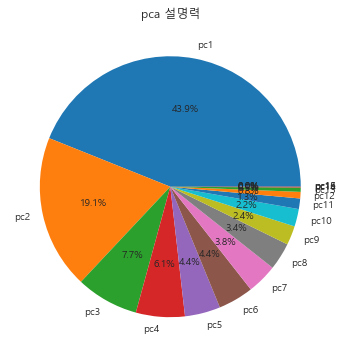

In [44]:
pca = PCA(random_state=0)
data_sample_dr = pca.fit_transform(df_Erangel_train_scaled1, res)

explained_variance_ratio = pd.Series(pca.explained_variance_ratio_, index=[f'pc{i}' for i in range(1, df_Erangel_train_scaled1.shape[1]+1)])

fig, ax = plt.subplots(1, 1, figsize=(15, 6))
explained_variance_ratio.plot.pie(autopct='%1.1f%%', ax= ax)
ax.set_ylabel('')
ax.set_title('pca 설명력')
plt.show()

#### clustering label 분포

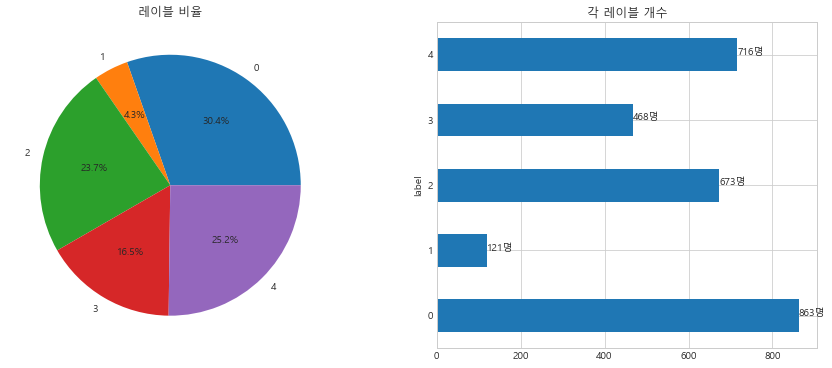

In [45]:
count_label = df_res_Erangel1.groupby('label')['kills'].count()

fig, ax = plt.subplots(1, 2, figsize=(15, 6))
count_label.plot.pie(autopct='%1.1f%%', ax= ax[0])
ax[0].set_ylabel('')
ax[0].set_title('레이블 비율')

df_res_Erangel1.groupby('label')['kills'].count().plot.barh(ax=ax[1])
ax[1].text(count_label[0], 0, f'{count_label[0]}명')
ax[1].text(count_label[1], 1, f'{count_label[1]}명')
ax[1].text(count_label[2], 2, f'{count_label[2]}명')
ax[1].text(count_label[3], 3, f'{count_label[3]}명')
ax[1].text(count_label[4], 4, f'{count_label[4]}명')
ax[1].set_title('각 레이블 개수')

plt.show()

#### - 컬럼별 분포

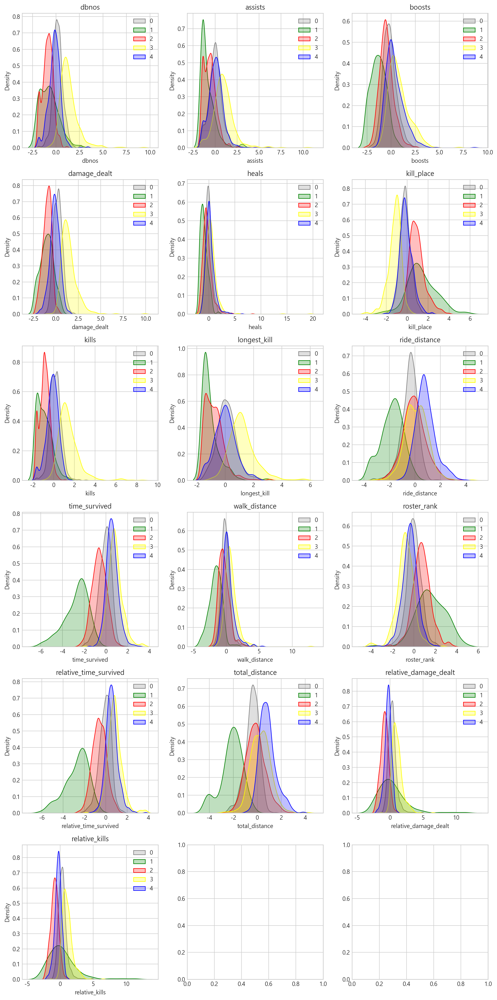

In [46]:
fig, ax = plt.subplots(6, 3, figsize=(12, 24), dpi=200)
for axis, col in zip(ax.flatten(), df_res_Erangel1.columns[:-1]):
    sns.kdeplot(data=df_res_Erangel1.query('label==0')[col], color='gray', shade=True, label='0', ax=axis)
    sns.kdeplot(data=df_res_Erangel1.query('label==1')[col], color='green', shade=True, label='1', ax=axis)
    sns.kdeplot(data=df_res_Erangel1.query('label==2')[col], color='red', shade=True, label='2', ax=axis)  
    sns.kdeplot(data=df_res_Erangel1.query('label==3')[col], color='yellow', shade=True, label='3', ax=axis)
    sns.kdeplot(data=df_res_Erangel1.query('label==4')[col], color='blue', shade=True, label='4', ax=axis)  
    axis.set_title(col)
    axis.legend()
fig.tight_layout()
fig.show()

#### 2차원 분포

##### scatter plot

<Figure size 1296x1296 with 0 Axes>

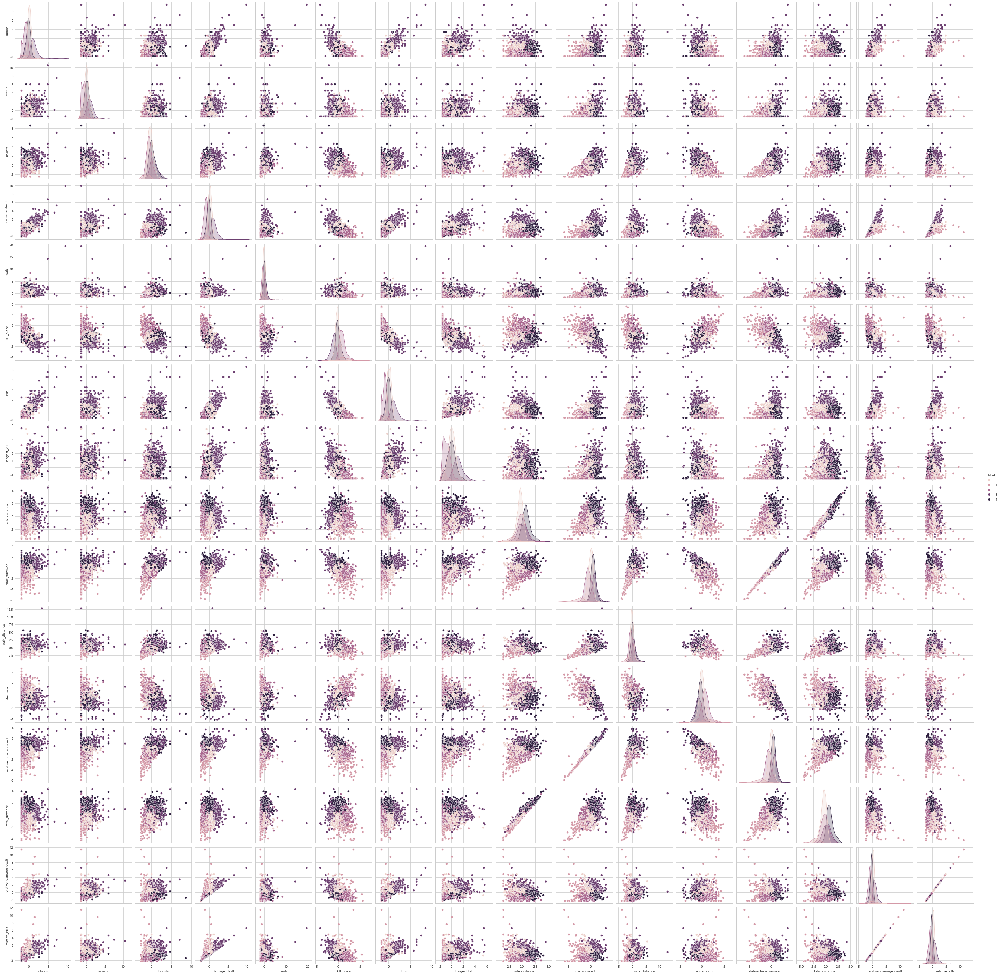

In [47]:
plt.figure(figsize=(18, 18))
sns.pairplot(df_res_Erangel1, hue='label')
plt.show()

------------------
---------------

### 8. 결과 분석

### 8.1. Miramar

#### - label별 center

In [56]:
center_Miramar0 = kmeans_Miramar.cluster_centers_[0]
center_Miramar1 = kmeans_Miramar.cluster_centers_[1]
center_Miramar2 = kmeans_Miramar.cluster_centers_[2]
center_Miramar3 = kmeans_Miramar.cluster_centers_[3]
center_Miramar4 = kmeans_Miramar.cluster_centers_[4]

In [72]:
df_res_Miramar1.index = df_Miramar_train1.index

#### - label별 grouping

In [73]:
label_Miramar0 = df_res_Miramar1.query('label==0').iloc[:,:-1]
label_Miramar1 = df_res_Miramar1.query('label==1').iloc[:,:-1]
label_Miramar2 = df_res_Miramar1.query('label==2').iloc[:,:-1]
label_Miramar3 = df_res_Miramar1.query('label==3').iloc[:,:-1]
label_Miramar4 = df_res_Miramar1.query('label==4').iloc[:,:-1]

#### - 중심으로부터 거리계산

In [74]:
label_Miramar0['dst_from_center'] = ((label_Miramar0.values-center_Miramar0)**2).sum(axis=1)
label_Miramar1['dst_from_center'] = ((label_Miramar1.values-center_Miramar1)**2).sum(axis=1)
label_Miramar2['dst_from_center'] = ((label_Miramar2.values-center_Miramar2)**2).sum(axis=1)
label_Miramar3['dst_from_center'] = ((label_Miramar3.values-center_Miramar3)**2).sum(axis=1)
label_Miramar4['dst_from_center'] = ((label_Miramar4.values-center_Miramar4)**2).sum(axis=1)

#### - 중심에 가까운 선수들

In [164]:
print('최상위권')
print(label_Miramar0.sort_values('dst_from_center').head(5).index.values)
print('')

print('중상위권')
print(label_Miramar4.sort_values('dst_from_center').head(5).index.values)
print('')
print('중위권')
print(label_Miramar1.sort_values('dst_from_center').head(5).index.values)
print('')

print('중하위권')
print(label_Miramar3.sort_values('dst_from_center').head(5).index.values)
print('')
print('하위권')
print(label_Miramar2.sort_values('dst_from_center').head(5).index.values)

최상위권
['4jaa' 'balefrost' 'clories' 'szylzen' 'ceejay18']

중상위권
['skuijke' 'casagrande' 'bsd' 'quick' 'justmoments']

중위권
['yacha' 'myl' 'naka' 'strayakents' 'dy577']

중하위권
['hamster' 'cuqbadak' 'hongtae' 'zai' 'art1x']

하위권
['winlovo' 'flukey' 'xiaobin' 'bulletb4ng' 'japanno1']


##### Miramar
* 최상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|4jaa|-|-|-|-|-|-|-|-|	LGY|
|Balefrost|102%	|292%|	52%	|23%|3:20:42|	55.3km	|13.33	|40%|	BRU|
|szylzen|116%	|169%|	55%		|21%|3:07:40	|46.7km|	13|	47%|		FIUM|
|clories|96%|	134%|	49%	|22%|2:53:22	|47.2km	|12.33	|35%|GHD|
|ceejay18|96%|108%|44%|21%|3:22:23|51.5km|8|40%|	AAP|

* 중상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|skuijke|108%|220%|48%|12%|3:11:46|	56.1km|	7	|50%|ENCE|
|casagrande|100%|	44%	|42%	|10%|2:48:46	|50.5km|	5	|30%|	STS|
|bsd|115%|	66%|	58%	|12%|3:11:08|	47.0km|	11.33|	40%|	GUP|
|quick|93%	|29%	|35%	|17%|2:47:44	|41.2km|	3.67	|30%|J2C|
|justmoments|88%|21%|43%|20%|2:55:58|50.2km|9.67|	45%|	PLM|

* 중위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|yacha|112%|149%	|37%	|8%|2:37:11|	51.9km	|3.33	|45%|			OPGG|
|myl|108%	|458%	|39%|	9%|2:50:27	|38.7km	|7.33	|45%|				PeRo|
|naka|-|-|-	|-|-|-|-|	-|ZVIRE|
|strayakents|-|-|-	|-|-|-|-|	-|			TRDT|
|japanno1|-|-|-	|-|-|-|-|	-|			Zoo|

* 중하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|hamster|-|-|-|-|-|-|-|-|-|
|cuqbadak|-|-|-|-|-|-|-|-|		 LKG|
|hongtae|-|-|-|-|-|-|-|-|		 BF|
|zai|-|-|-|-|-|-|-|-|4KB|
|art1x|102%	|33%	|53%	|16%|2:09:05|	30.3km|	9.67	|40%|		 	TM|


* 최하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|winlovo|-|-|-|-|-|-|-|-|PAN|
|flukey|-|-|-|-|-|-|-|-|		GDE|
|xiaobin|-|-|-|-|-|-|-|-|		-|
|bulletb4ng|-|-|-|-|-|-|-|-|			MD|
|japanno1|-|-|-|-|-|-|-|-|Zoo|

-------------------

### 8.2.  Erangel

#### - label별 center

In [60]:
center_Erangel0 = kmeans_Erangel.cluster_centers_[0]
center_Erangel1 = kmeans_Erangel.cluster_centers_[1]
center_Erangel2 = kmeans_Erangel.cluster_centers_[2]
center_Erangel3 = kmeans_Erangel.cluster_centers_[3]
center_Erangel4 = kmeans_Erangel.cluster_centers_[4]

In [76]:
df_res_Erangel1.index = df_Erangel_train1.index

#### - label별 grouping

In [77]:
label_Erangel0 = df_res_Erangel1.query('label==0').iloc[:,:-1]
label_Erangel1 = df_res_Erangel1.query('label==1').iloc[:,:-1]
label_Erangel2 = df_res_Erangel1.query('label==2').iloc[:,:-1]
label_Erangel3 = df_res_Erangel1.query('label==3').iloc[:,:-1]
label_Erangel4 = df_res_Erangel1.query('label==4').iloc[:,:-1]

#### - 중심으로부터 거리계산

In [78]:
label_Erangel0['dst_from_center'] = ((label_Erangel0.values-center_Erangel0)**2).sum(axis=1)
label_Erangel1['dst_from_center'] = ((label_Erangel1.values-center_Erangel1)**2).sum(axis=1)
label_Erangel2['dst_from_center'] = ((label_Erangel2.values-center_Erangel2)**2).sum(axis=1)
label_Erangel3['dst_from_center'] = ((label_Erangel3.values-center_Erangel3)**2).sum(axis=1)
label_Erangel4['dst_from_center'] = ((label_Erangel4.values-center_Erangel4)**2).sum(axis=1)

#### - 중심에 가까운 선수들

In [167]:
print('최상위권')
print(label_Erangel3.sort_values('dst_from_center').head(5).index.values)
print('')

print('중상위권')
print(label_Erangel4.sort_values('dst_from_center').head(5).index.values)
print('')
print('중위권')
print(label_Erangel0.sort_values('dst_from_center').head(5).index.values)
print('')

print('중하위권')
print(label_Erangel2.sort_values('dst_from_center').head(5).index.values)
print('')
print('하위권')
print(label_Erangel1.sort_values('dst_from_center').head(5).index.values)

최상위권
['hiagguin' 'jouxy' 'rustyzera' 'selfish' 'kodak1d']

중상위권
['ykuz' 'mamu' 'wo1f' 'freemeplease' 'draft']

중위권
['iroh' 'sparrow' 'shuhroo' 'jefflocka' 'aleo']

중하위권
['mardones' 'znannn' 'r1ptid3-' 'shiniichii-' 'vampiregame']

하위권
['fudgexo' 'bobomilk' 'hackben' 'whysoez' 'keres']


##### Erangel
* 최상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|hiagguin|90%|	23%|	41%|	20%|1:56:54|	36.4km|	7.33	|40%|	2ND|
|jouxy|95%|	3%	|40%|	23%|2:32:22|	42.5km|	5	|40%|	DIX|
|rustyzera|123%|181%	|59%	|13%|2:59:13|	51.0km|	11.33	|45%|TROG|
|selfish|92%|70%	|39%	|10%|2:58:08	|44.8km|	7	|35%|IN|
|kodak1d|83%|	42%	|35%	|10%|2:45:40	|45.3km|	6.33	|35%|	MIGO|

    - jourxy : 5달전 play
    

* 중상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|ykuz|113%|	51%	|46%	|21%|3:15:40|	46.1km|	9.33	|25%|YK|
|mamu|78%|	418%	|34%|	8%|2:55:24	|37.7km|	6.33	|45%|		PeRo|
|wo1f|-|-|-|-|-|-|-|-|	YAHO|
|freemeplease|88%|	138%	|40%|	12%|2:34:01|	49.6km|	8.33	|35%|GAS|
|draft|-|-|-|-|-|-|-|-|AZG/BJ|
    
    * draft 한국인 2명

* 중위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|iroh|83%|55%	|38%	|21%|2:44:00|	45.8km|	6.33	|45%|TSM|
|sparrow|99%	|186%	|51%	|14%|2:50:50	|38.1km	|9.67	|50%|ATA|
|shuhroo|109%	|2%|	46%|	18%|2:54:01|	47.6km|	6|	35%|RUM|
|jefflocka|99%|	276%	|45%	|14%|2:57:31	|50.6km|	7.67	|50%|				emT|
|aleo|-|-|-	|-|-|-|-|	-|			MAO|

* 중하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|mardones|-|-|-|-|-|-|-|-|MAD|
|r1ptid3-|-|-|-|-|-|-|-|-|		 TMS|
|shiniichii-|-|-|-|-|-|-|-|-|		 TMS|
|znannn|-|-|-|-|-|-|-|-|	ETP|
|vampiregame|2:41:42|	44.5km|	3.33|	30%|2:41:42|	44.5km|	3.33|	30%|		 	PINK|


* 최하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|fudgexo|-|-|-|-|-|-|-|-|AnT|
|bobomilk|-|-|-|-|-|-|-|-|	Rush|
|hackben|-|-|-|-|-|-|-|-| FPC|
|whysoez|-|-|-|-|-|-|-|-|	PU|
|keres|119%|	65%	|38%|	12%|2:18:42	|41.1km	|4.33	|40%|	XXX|

### 8.3. 공통 결과

#### - 맵별 label 순서

* Miramar
    - 0 > 4 > 1 > 3> 2

* Erangel
    - 3 > 4 > 0 > 2> 1

#### - 겹치는 비율

In [137]:
def compute_common(erangel, miramar):
    union = len(set(miramar.sort_values('dst_from_center').index)|set(erangel.sort_values('dst_from_center').index))
    intersection = len(set(miramar.sort_values('dst_from_center').index)&set(erangel.sort_values('dst_from_center').index))
    return intersection / union * 100

In [138]:
common = [[0]*5 for i in range(5)]
for i, x in enumerate([label_Erangel3, label_Erangel4, label_Erangel0, label_Erangel2, label_Erangel1]):
    for j, y in enumerate([label_Miramar0, label_Miramar4, label_Miramar1, label_Miramar3, label_Miramar2]):
        common[i][j] = compute_common(x, y)
        
pd.DataFrame(common, index = ['Erangel3', 'Erangel4', 'Erangel0', 'Erangel2', 'Erangel1'],
                    columns = ['Miramar0', 'Miramar4', 'Miramar1', 'Miramar3', 'Miramar2'])

,Miramar0,Miramar4,Miramar1,Miramar3,Miramar2
Erangel3,19.484702,15.955766,7.210300,3.096539,2.481752
Erangel4,4.320337,20.590302,12.981132,13.861386,3.825137
Erangel0,5.767442,20.504528,23.146067,9.698276,3.490566
Erangel2,2.823018,8.706953,11.417625,23.681776,12.113721
Erangel1,2.864583,1.356239,4.398148,3.153745,6.606607


#### - 중심으로부터 가까운 공통 선수들

In [158]:
print('공통 최상위권')
print(set(label_Miramar0.sort_values('dst_from_center').head(40).index)\
&set(label_Erangel3.sort_values('dst_from_center').head(40).index))
print('')
print('공통 중상위권')
print(set(label_Miramar4.sort_values('dst_from_center').head(40).index)\
&set(label_Erangel4.sort_values('dst_from_center').head(40).index))
print('')
print('공통 중위권')
print(set(label_Miramar1.sort_values('dst_from_center').head(40).index)\
&set(label_Erangel0.sort_values('dst_from_center').head(40).index))
print('')
print('공통 중하위권')
print(set(label_Miramar3.sort_values('dst_from_center').head(40).index)\
&set(label_Erangel2.sort_values('dst_from_center').head(40).index))
print('')
print('공통 하위권')
print(set(label_Miramar2.sort_values('dst_from_center').head(100).index)\
&set(label_Erangel1.sort_values('dst_from_center').head(100).index))
print('')


공통 최상위권
{'uncivil', 'szylzen', 'noardra', 'ceejay18'}

공통 중상위권
{'skuijke', '777', 'yehi', 'relance', 'snapzx'}

공통 중위권
{'iroh', 'monharti', 'yacha'}

공통 중하위권
{'znannn', 'hongtae', 'vinzdodz', 'skazka'}

공통 하위권
{'oldm8', 'rurnrurn', 'leooo', 'godlike', 'mittzan', 'flukey', 'minggu'}



##### 공통
* 최상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|ceejay18|96%|108%|44%|21%|3:22:23|51.5km|8|40%|	AAP|
|Noardra|98%	|250%|	52%	|23%|2:52:26|	49.3km|	15	|45%|	BRU|
|szylzen|116%	|169%|	57%	|10%|3:07:40	|46.7km|	13|	47%|FIUM|
|Uncivil|121%|	250%	|47%	|17%|2:53:28|	48.0km|	5.33|	50%|-|

* 중상위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|777|117%|68%|42%|	19%|3:02:57|	51.5km|	6|20%|TE|
|relance|87%|24%	|34%|	8%|2:29:04	|52.1km	|3	|35%|UND|
|skuijke|108%|220%|48%|12%|3:11:46|	56.1km|	7	|50%|ENCE|
|snapzx|-|-|-|-|-|-|	-|-|G2G|
|Yehi|-|-|-|-|-|-|	-|-|BOG|

* 중위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|Iroh|83%	|55%	|38%	|21%|2:44:00	|45.8km	|6.33|	45%|TSM|
|monharti|83%|	4%	|31%	|12%|2:30:37	|38.0km|	2	|20%|			1I|
|yacha|112%|149%	|37%	|8%|2:37:11|	51.9km	|3.33	|45%|			OPGG|

* 중하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|znannn|-|-|-|-|-|-|-|-|	ETP|
|hongtae|-|-|-|-|-|-|-|-|		BF|
|vinzdodz|-|-|-|-|-|-|-|-|		 AI|
|skazka|103%|	55%|	35%	|10%|2:24:47|	39.1km|	3	|30%|		 	ORN|


* 최하위권
|name| FORM|RATING|MATCH PERFORMANCE|PRECISION |SURVIVAL|DISTANCE|KILLS|EXPERIENCE|팀|
|---|---|---|---|---|---|---|---|---|---|
|flukey|-|-|-|-|-|-|-|-|PAN|
|GodLike3|-|-|-|-|-|-|-|-|		GDE|
|leooo|-|-|-|-|-|-|-|-|		TLA|